<img src="https://user-images.strikinglycdn.com/res/hrscywv4p/image/upload/c_limit,fl_lossy,h_300,w_300,f_auto,q_auto/1266110/Logo_wzxi0f.png" style="float: left; margin: 20px; height: 55px">

***Ignoranti, quem portum petat, nullus suss ventus est - Seneca***

For those who dont't know which port they are headed to, no wind is favorable.

# 1. Pandas Visualization

In [0]:
%matplotlib inline

In [0]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [0]:
# We dont Probably need the Gridlines. Do we? If yes comment this line
sns.set(style="ticks")

flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71"]
flatui = sns.color_palette(flatui)

###### Processing

In [0]:
player_df = pd.read_csv("data.csv")

In [0]:
def wage_split(x):
    try:
        return int(x.split("K")[0][1:])
    except:
        return 0
player_df['Wage'] = player_df['Wage'].apply(lambda x : wage_split(x))

def value_split(x):
    try:
        if 'M' in x:
            return float(x.split("M")[0][1:])
        elif 'K' in x:
            return float(x.split("K")[0][1:])/1000
    except:
        return 0
    
player_df['Value'] = player_df['Value'].apply(lambda x : value_split(x))

In [0]:
numcols = [
 'Overall',
 'Potential',
'Crossing','Finishing',  'ShortPassing',  'Dribbling','LongPassing', 'BallControl', 'Acceleration',
       'SprintSpeed', 'Agility',  'Stamina',
 'Value','Wage']
catcols = ['Name','Club','Nationality','Preferred Foot','Position','Body Type']

In [0]:
player_df = player_df[numcols+catcols]

In [0]:
filtered_player_df = player_df[(player_df['Club'].isin(['FC Barcelona', 'Paris Saint-Germain',
       'Manchester United', 'Manchester City', 'Chelsea', 'Real Madrid','FC Porto','FC Bayern München'])) & 
                      (player_df['Nationality'].isin(['England', 'Brazil', 'Argentina',
       'Brazil', 'Italy','Spain','Germany'])) 
                     ]

df_plot = filtered_player_df.groupby(['Club', 'Nationality']).size().reset_index().pivot(columns='Club', index='Nationality', values=0).reset_index()


In [0]:
max_wage = filtered_player_df.Wage.max()
max_wage_player = filtered_player_df[(player_df['Wage'] == max_wage)]['Name'].values[0]

C:\Users\javier.fernandez\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


In [0]:
df1 = df_plot.set_index('Nationality').T

### Stack Bars

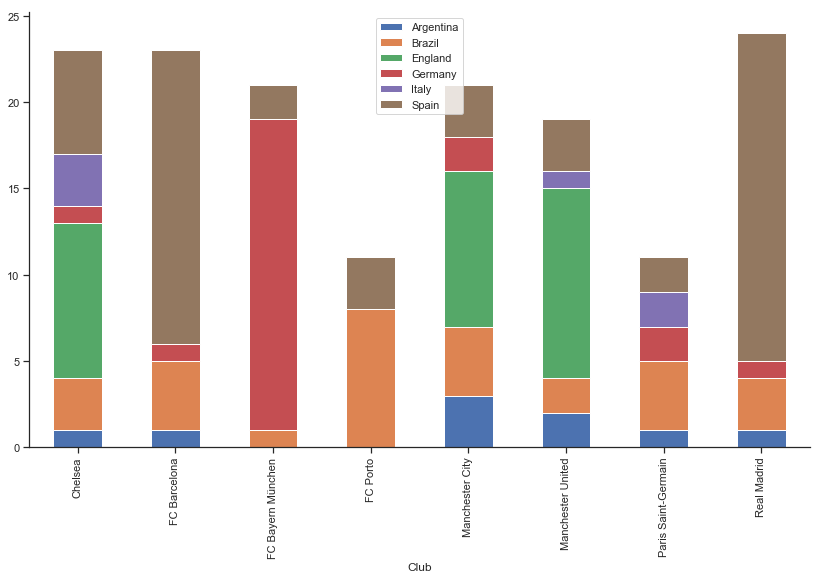

In [0]:
g = df1.plot(kind='bar', stacked=True, 
            color=sns.color_palette())

sns.despine()
g.figure.set_size_inches(14,8)

plt.legend(loc='upper center')

plt.show()

### Hexbins Plot

In [0]:
recent_grads = pd.read_csv('recent-grads.csv')

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


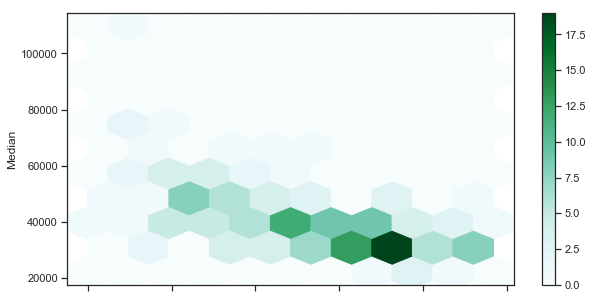

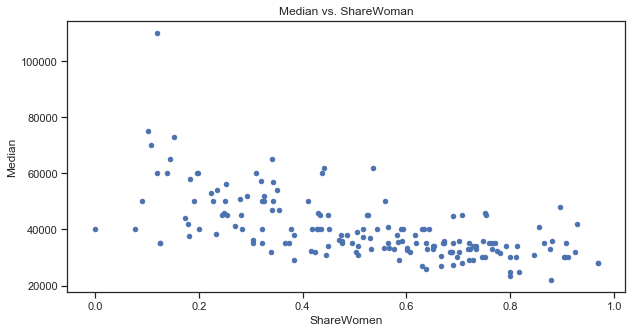

In [0]:
recent_grads.plot.hexbin(x ='ShareWomen', y ='Median',
                         gridsize = 10,
                        figsize = (10, 5))

recent_grads.plot(x ='ShareWomen', y ='Median',
                   kind ='scatter',
                   title ='Median vs. ShareWoman',
                   figsize = (10, 5))

plt.show()

# 2. Geographical Graphs

### Basemap

In [0]:
import os
os.environ["PROJ_LIB"] = "C:\\Users\\javier.fernandez\\Anaconda3\\Library\\share" 
from mpl_toolkits.basemap import Basemap

In [0]:
airlines = pd.read_csv('airlines.csv')
airports = pd.read_csv('airports.csv')
geo_routes = pd.read_csv('geo_routes.csv')

In [0]:
m = Basemap(projection = 'merc', llcrnrlat = -80,
                                 urcrnrlat = 80,
                                 llcrnrlon = -180,
                                 urcrnrlon = 180)

In [0]:
longitudes = airports['longitude'].tolist()
latitudes = airports['latitude'].tolist()

x, y = m(longitudes, latitudes)

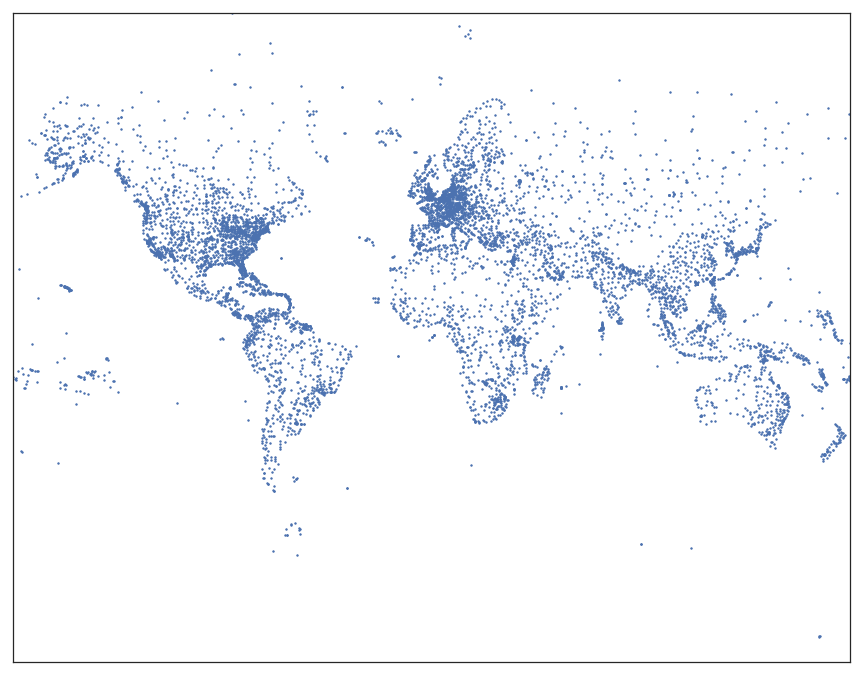

In [0]:
plt.figure(figsize=(15, 20))
m.scatter(x, y, s = 2)
plt.show()

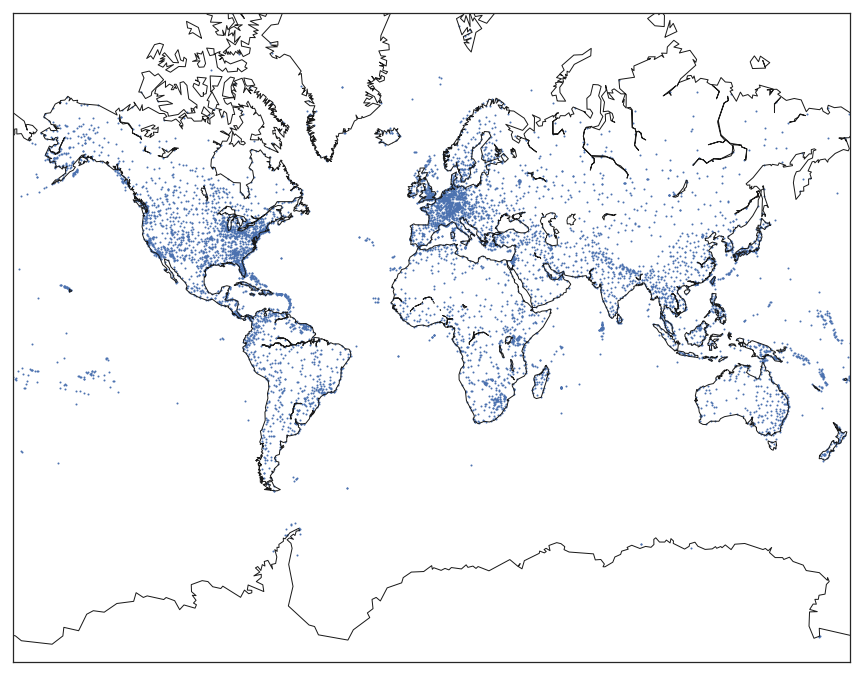

In [0]:
plt.figure(figsize=(15, 20))
m.scatter(x, y, s = 1)
m.drawcoastlines()
plt.show()

In [0]:
dfw = geo_routes[geo_routes['source'] == 'DFW']

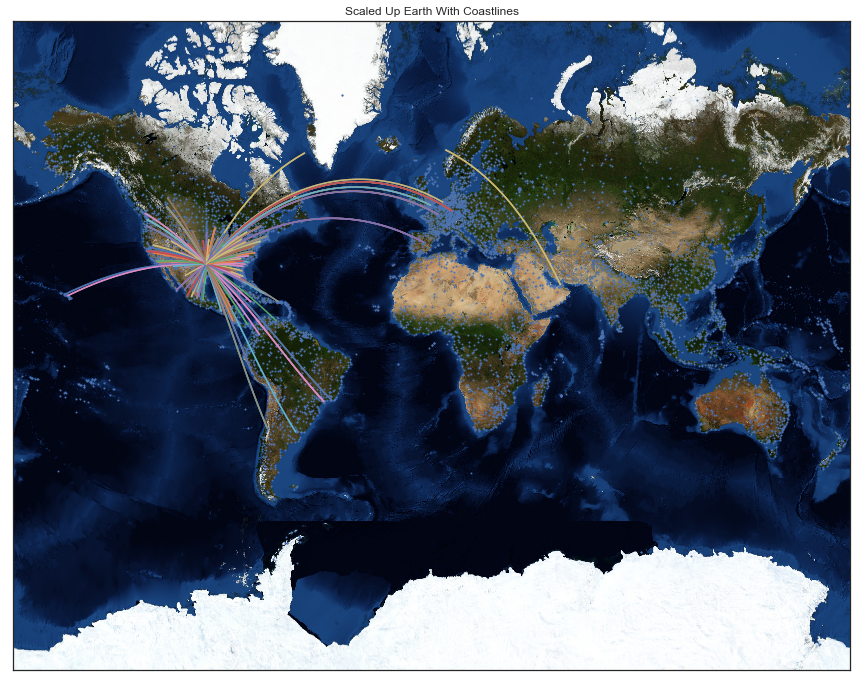

In [0]:
plt.figure(figsize = (15, 20))
plt.title('Scaled Up Earth With Coastlines')
m.scatter(x, y, s = 1)

def create_great_circles(df):
    for index, row in df.iterrows():
        if abs(row['end_lat'] - row['start_lat']) < 180:
            if abs(row['end_lon'] - row['start_lon']) < 180:
                m.drawgreatcircle(row['start_lon'],
                                  row['start_lat'],
                                  row['end_lon'], 
                                  row['end_lat'])
    pass

m.bluemarble()

create_great_circles(dfw)

plt.show()   

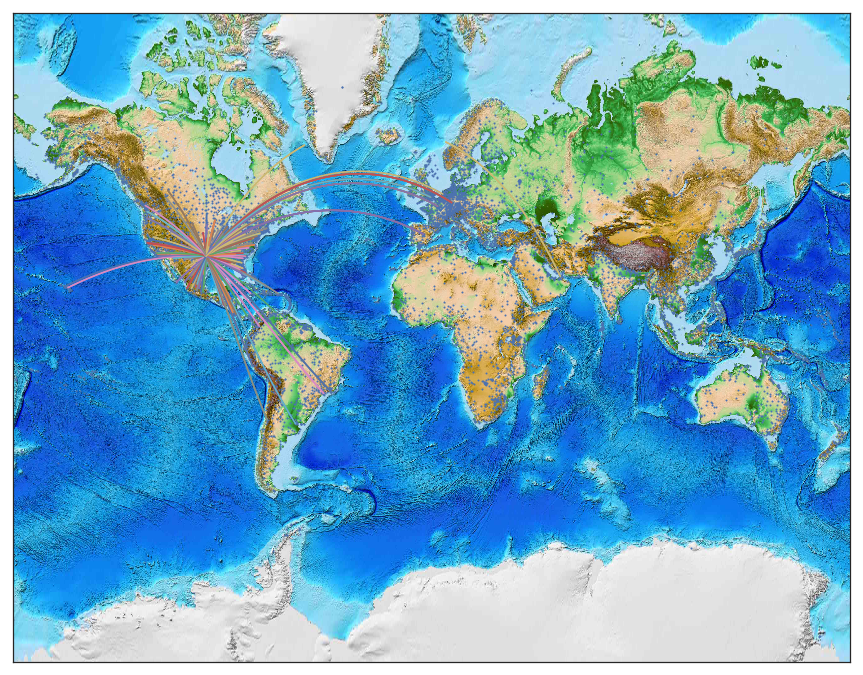

In [0]:
plt.figure(figsize = (15, 20))
m.scatter(x, y, s = 1)
m.etopo()

create_great_circles(dfw)

plt.show()   

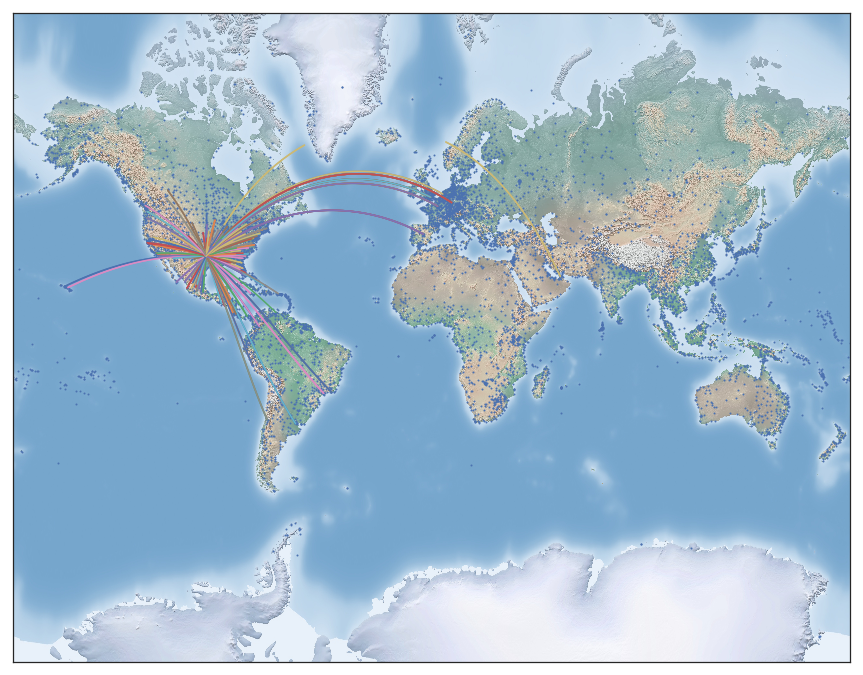

In [0]:
plt.figure(figsize = (15, 20))
m.scatter(x, y, s = 1)
m.shadedrelief()

create_great_circles(dfw)

plt.show()   

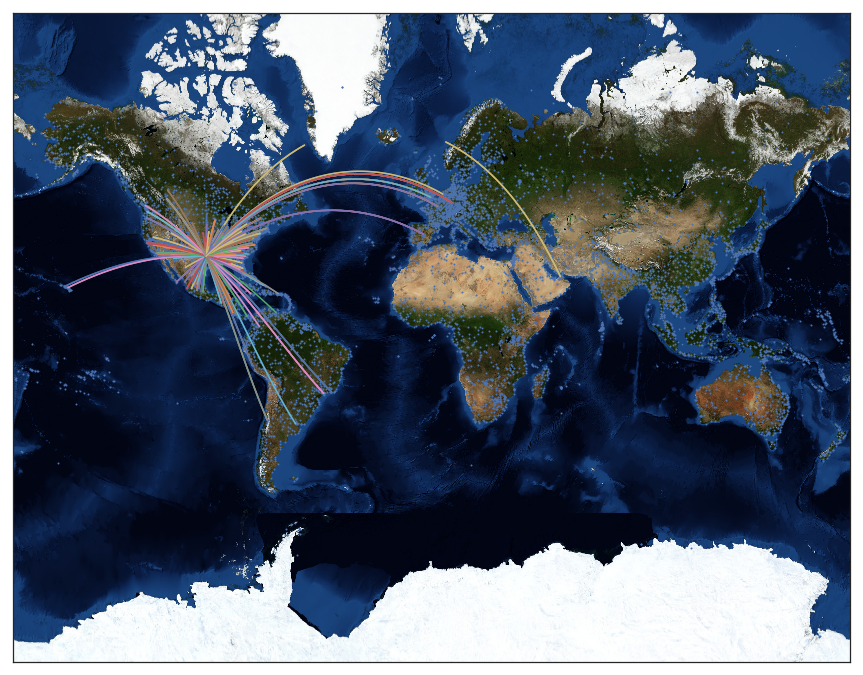

In [0]:
plt.figure(figsize = (15, 20))
m.scatter(x, y, s = 1)
m.warpimage()

create_great_circles(dfw)

plt.show()

### Folium

Info from this [article](https://towardsdatascience.com/data-101s-spatial-visualizations-and-analysis-in-python-with-folium-39730da2adf)

[Examples](https://nbviewer.jupyter.org/github/python-visualization/)

In [0]:
import folium
from folium.plugins import HeatMapWithTime
from folium.plugins import HeatMap
from folium.plugins import HeatMapWithTime

In [0]:
df_train = pd.read_csv('train_taxi.csv').drop(columns=['trip_duration', 'dropoff_datetime'])
df_test = pd.read_csv('test_taxi.csv')
df = pd.concat([df_train, df_test], sort=False, ignore_index=True)
df.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N


In [0]:
df.pickup_datetime = pd.to_datetime(df.pickup_datetime, format='%Y-%m-%d %H:%M:%S')
df['month'] = df.pickup_datetime.apply(lambda x: x.month)
df['week'] = df.pickup_datetime.apply(lambda x: x.week)
df['day'] = df.pickup_datetime.apply(lambda x: x.day)
df['hour'] = df.pickup_datetime.apply(lambda x: x.hour)

In [0]:
def generateBaseMap(default_location=[40.693943, -73.985880], default_zoom_start=11):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map

Arguments:

**location:** Define the default location to zoom at when rendering the map <br>
**zoom_start:** The zoom level that the map will default to when rendering the map <br>
**control_scale:** Shows the map scale for a given zoom level

In [0]:
base_map = generateBaseMap()
base_map

In [0]:
df_copy = df[df.month>4].copy()
df_copy['count'] = 1

In [0]:
base_map = generateBaseMap()
HeatMap(data=df_copy[['pickup_latitude', 'pickup_longitude', 'count']].groupby(['pickup_latitude', 'pickup_longitude'])
        .sum().reset_index().values.tolist(), 
        radius=8, 
        max_zoom=13).add_to(base_map)

In [0]:
base_map

In [0]:
base_map.add_child(folium.ClickForMarker(popup='Potential Location'))

In [0]:
df_hour_list = []
for hour in df_copy.hour.sort_values().unique():
    df_hour_list.append(df_copy.loc[df_copy.hour == hour, ['pickup_latitude', 'pickup_longitude', 'count']].groupby(['pickup_latitude', 'pickup_longitude']).sum().reset_index().values.tolist())

In [0]:
base_map = generateBaseMap(default_zoom_start=11)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

In [0]:
print(folium.__version__)

In [0]:
url = 'https://raw.githubusercontent.com/python-visualization/folium/master/examples/data'
state_geo = f'{url}/us-states.json'
state_unemployment = f'{url}/US_Unemployment_Oct2012.csv'

state_data = pd.read_csv(state_unemployment)

m = folium.Map(
    location=[48, -102],
    zoom_start=3,
    tiles='Stamen Toner'
)

folium.Choropleth(
    state_geo,
    data=state_data,
    columns=['State', 'Unemployment'],
    key_on='feature.id',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Unemployment Rate (%)'
).add_to(m)


popup = 'Must be on top of the choropleth'

folium.CircleMarker(
    location=[48, -102],
    radius=10,
    fill=True,
    popup=popup,
    weight=1,
).add_to(m)

# m.save(os.path.join('results', 'CheckZorder.html'))

m

# 3. Plotly

Many up-to-date [examples](https://plot.ly/python/#basic-charts)

In [0]:
import plotly.express as px
import plotly.graph_objects as go

In [0]:
tips = px.data.tips()
gapminder = px.data.gapminder()
gapminder_canada = gapminder.query("country=='Canada'")
gapminder_oceania = gapminder.query("continent=='Oceania'")
gapminder_continent = gapminder.query("continent != 'Asia'") # remove Asia for visibility
iris = px.data.iris()
election = px.data.election()
z_data = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/api_docs/mt_bruno_elevation.csv')

### Histograms

Copied from [here](https://plot.ly/python/histograms/)

In [0]:
fig = px.histogram(tips, x="total_bill", nbins=30)
fig.show()

In [0]:
fig = px.histogram(tips, x="day")
fig.show()

In [0]:
fig = px.histogram(tips, x="total_bill",
                   title='Histogram of bills',
                   labels={'total_bill':'total bill'}, # can specify one label per df column
                   opacity=0.8,
                   log_y=True, # represent bars with log scale
                   color_discrete_sequence=['indianred'] # color of histogram bars
                   )
fig.show()

In [0]:
fig = px.histogram(tips, x="total_bill", color="sex")
fig.show()

In [0]:
fig = px.histogram(tips, x="total_bill", color="sex", marginal="rug", # can be `box`, `violin`
                         hover_data=tips.columns)
fig.show()

In [0]:
x0 = np.random.randn(500)
x1 = np.random.randn(500) + 1

fig = go.Figure()
fig.add_trace(go.Histogram(
    x=x0,
    histnorm='percent',
    name='control', # name used in legend and hover labels
    xbins=dict( # bins used for histogram
        start=-4.0,
        end=3.0,
        size=0.5
    ),
    marker_color='#EB89B5',
    opacity=0.75
))
fig.add_trace(go.Histogram(
    x=x1,
    histnorm='percent',
    name='experimental',
    xbins=dict(
        start=-3.0,
        end=4,
        size=0.5
    ),
    marker_color='#330C73',
    opacity=0.75
))

fig.update_layout(
    title_text='Sampled Results', # title of plot
    xaxis_title_text='Value', # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0.2, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)

fig.show()

### Scatter Plots

Copied from [here](Copied from [here](https://plot.ly/python/line-and-scatter/)

In [0]:
fig = px.scatter(iris, x="sepal_width", y="sepal_length")
fig.show(config={'scrollZoom': True, 'displayModeBar': False})
fig.show()

In [0]:
fig = px.scatter(iris, x="sepal_width", y="sepal_length", color="species",
                 size='petal_length', hover_data=['petal_width'])
fig.show()

In [0]:
fig = go.Figure(data=go.Scatter(
    y = np.random.randn(500),
    mode='markers',
    marker=dict(
        size=16,
        color=np.random.randn(500), #set color equal to a variable
        colorscale='Viridis', # one of plotly colorscales
        showscale=True
    )
))

fig.show()

### Line Charts

Copied from [here](https://plot.ly/python/line-charts/)

In [0]:
fig = px.line(gapminder_canada, x="year", y="lifeExp", title='Life expectancy in Canada')
fig.show()

In [0]:
fig = px.line(gapminder_oceania, x="year", y="lifeExp", color='country')
fig.show()

In [0]:
fig = px.line(gapminder_continent, x="year", y="lifeExp", color="continent",
              line_group="country", hover_name="country")
fig.show()

### Pie Charts

Copied from [here](https://plot.ly/python/pie-charts/)

In [0]:
labels = ['Oxygen','Hydrogen','Carbon_Dioxide','Nitrogen']
values = [4500, 2500, 1053, 500]

fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.3)])
fig.show()

### Bar Charts

[Refence](https://plot.ly/python/bar-charts/)

In [0]:
fig = px.bar(gapminder_canada, x='year', y='pop')
fig.show()

In [0]:
fig = px.bar(gapminder_canada, x='year', y='pop',
             hover_data=['lifeExp', 'gdpPercap'], color='lifeExp',
             labels={'pop':'population of Canada'}, height=600)
fig.show()

In [0]:
tips

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4
5,25.29,4.71,Male,No,Sun,Dinner,4
6,8.77,2.00,Male,No,Sun,Dinner,2
7,26.88,3.12,Male,No,Sun,Dinner,4
8,15.04,1.96,Male,No,Sun,Dinner,2
9,14.78,3.23,Male,No,Sun,Dinner,2


In [0]:
fig = px.bar(tips, x="sex", y="total_bill", color="smoker",  barmode="group",
             facet_row="time", facet_col="day",
             category_orders={"day": ["Thur", "Fri", "Sat", "Sun"],
                              "time": ["Lunch", "Dinner"]})
fig.show()

### Strip plots

[Reference](https://plot.ly/python/plotly-express/)

In [0]:
fig = px.strip(tips, x="total_bill", y="time", orientation="h", color="smoker")
fig.show()

### 3D

[Reference](https://plot.ly/python/3d-surface-plots/)

In [0]:
fig = px.scatter_3d(election, x="Joly", y="Coderre", z="Bergeron", color="winner", size="total", hover_name="district",
                  symbol="result", color_discrete_map = {"Joly": "blue", "Bergeron": "green", "Coderre":"red"})
fig.show()

In [0]:
fig = go.Figure(data=[go.Surface(z=z_data.values)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))
fig.update_layout(title='Mt Bruno Elevation', autosize=False,
                  scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
                  width=1000, height=1000,
                  margin=dict(l=65, r=50, b=65, t=90)
)

fig.show()

### Geographical 

[Reference](https://plot.ly/python/plotly-express/)

In [0]:
fig = px.scatter_geo(gapminder, locations="iso_alpha", color="continent", hover_name="country", size="pop",
               animation_frame="year", projection="natural earth")
fig.show()

In [0]:
fig = px.scatter_geo(gapminder, locations="iso_alpha", color="continent", hover_name="country", size="pop",
               animation_frame="year", projection="orthographic")
fig.show()

In [0]:
fig = px.choropleth(gapminder, locations="iso_alpha", color="lifeExp", 
                    hover_name="country", animation_frame="year", range_color=[20,80])
fig.show()

### Animations

[Reference](https://plot.ly/python/animations/)

In [0]:
px.scatter(gapminder, x="gdpPercap", y="lifeExp", animation_frame="year", animation_group="country",
           size="pop", color="continent", hover_name="country",
           log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

### Widgets

[Reference](https://plot.ly/python/chart-events/)

In [0]:
from ipywidgets import widgets

In [0]:
df = pd.read_csv(
    'https://raw.githubusercontent.com/yankev/testing/master/datasets/nycflights.csv')
df = df.drop(df.columns[[0]], axis=1)

df.sample(3) # Take 3 random rows

,year,month,day,dep_time,dep_delay,arr_time,arr_delay,carrier,tailnum,flight,origin,dest,air_time,distance,hour,minute
284317,2013,8,5,1709.0,4.0,1947.0,12.0,UA,N27724,1625,EWR,DEN,244.0,1605,17.0,9.0
289674,2013,8,11,1023.0,-7.0,1136.0,-6.0,EV,N14993,3853,EWR,BNA,116.0,748,10.0,23.0
23782,2013,1,28,1341.0,-4.0,1700.0,-5.0,AA,N329AA,117,JFK,LAX,343.0,2475,13.0,41.0


In [0]:
df['carrier'].unique() # Airlines

array(['UA', 'AA', 'B6', 'DL', 'EV', 'MQ', 'US', 'WN', 'VX', 'FL', 'AS',
       '9E', 'F9', 'HA', 'YV', 'OO'], dtype=object)

In [0]:
month = widgets.IntSlider(
    value=1.0,
    min=1.0,
    max=12.0,
    step=1.0,
    description='Month:',
    continuous_update=False
)

use_date = widgets.Checkbox(
    description='Date: ',
    value=True,
)

container = widgets.HBox(children=[use_date, month])

textbox = widgets.Dropdown(
    description='Airline:   ',
    value='DL',
    options=df['carrier'].unique().tolist()
)

origin = widgets.Dropdown(
    options=list(df['origin'].unique()),
    value='LGA',
    description='Origin Airport:',
)


# Assign an emptry figure widget with two traces
trace1 = go.Histogram(x=df['arr_delay'], opacity=0.75, name='Arrival Delays')
trace2 = go.Histogram(x=df['dep_delay'], opacity=0.75, name='Departure Delays')
g = go.FigureWidget(data=[trace1, trace2],
                    layout=go.Layout(
                        title=dict(
                            text='NYC FlightDatabase'
                        ),
                        barmode='overlay'
                    ))

In [0]:
def validate():
    if origin.value in df['origin'].unique() and textbox.value in df['carrier'].unique():
        return True
    else:
        return False


def response(change):
    if validate():
        if use_date.value:
            filter_list = [i and j and k for i, j, k in
                           zip(df['month'] == month.value, df['carrier'] == textbox.value,
                               df['origin'] == origin.value)]
            temp_df = df[filter_list]

        else:
            filter_list = [i and j for i, j in
                           zip(df['carrier'] == 'DL', df['origin'] == origin.value)]
            temp_df = df[filter_list]
        x1 = temp_df['arr_delay']
        x2 = temp_df['dep_delay']
        with g.batch_update():
            g.data[0].x = x1
            g.data[1].x = x2
            g.layout.barmode = 'overlay'
            g.layout.xaxis.title = 'Delay in Minutes'
            g.layout.yaxis.title = 'Number of Delays'


origin.observe(response, names="value")
textbox.observe(response, names="value")
month.observe(response, names="value")
use_date.observe(response, names="value")

In [0]:
container2 = widgets.HBox([origin, textbox])
widgets.VBox([container,
              container2,
              g])

In [0]:
x = np.random.rand(100)
y = np.random.rand(100)

f = go.FigureWidget([go.Scatter(x=x, y=y, mode='markers')])

scatter = f.data[0]
colors = ['#a3a7e4'] * 100
scatter.marker.color = colors
scatter.marker.size = [10] * 100
f.layout.hovermode = 'closest'


# create our callback function
def update_point(trace, points, selector):
    c = list(scatter.marker.color)
    s = list(scatter.marker.size)
    for i in points.point_inds:
        c[i] = '#bae2be'
        s[i] = 20
        with f.batch_update():
            scatter.marker.color = c
            scatter.marker.size = s


scatter.on_click(update_point)

f

FigureWidget({
    'data': [{'marker': {'color': [#a3a7e4, #a3a7e4, #a3a7e4, #a3a7e4, #a3a7e4,
               …

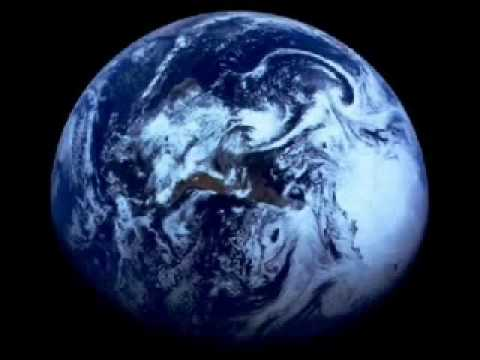

In [0]:
from IPython.display import YouTubeVideo
YouTubeVideo("wupToqz1e2g")